<a href="https://colab.research.google.com/github/nilu-ai/React_Wali_revision/blob/main/Fttx_SAD_HAPPY.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode
import os
from ipywidgets import widgets

def create_folder_if_not_exists(folder_name):
    if not os.path.exists(folder_name):
        os.makedirs(folder_name)

def take_photo_live(id, quality=0.8):
    folder_name = os.path.join('/content/Data/Test/', str(id))
    create_folder_if_not_exists(folder_name)



    js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      const cancel = document.createElement('button');
      cancel.textContent = 'Cancel';
      div.appendChild(capture);
      div.appendChild(cancel);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      let stop = false;
      const images = [];

      // Capture images until cancel is clicked.
      while (!stop) {
        await new Promise((resolve) => {
          capture.onclick = () => {
            const canvas = document.createElement('canvas');
            canvas.width = video.videoWidth;
            canvas.height = video.videoHeight;
            canvas.getContext('2d').drawImage(video, 0, 0);
            const imageData = canvas.toDataURL('image/jpeg', quality);
            images.push(imageData);
            resolve();
          };
          cancel.onclick = () => {
            stop = true;
            resolve();
          };
        });
      }

      stream.getVideoTracks()[0].stop();
      div.remove();
      return images;
    }
    ''')

    display(js)
    images = eval_js('takePhoto({})'.format(quality))

    filenames = []
    for i, image_data in enumerate(images):
        binary = b64decode(image_data.split(',')[1])
        filename = os.path.join(folder_name, 'photo{}.jpg'.format(i))
        filenames.append(filename)
        with open(filename, 'wb') as f:
            f.write(binary)

    return filenames

id_widget = widgets.Text(description="Enter ID:")
display(id_widget)

def on_button_clicked(b):
    try:
        id = id_widget.value
        filenames = take_photo_live(id)
        print('Saved to:')
        for filename in filenames:
            print(filename)
    except Exception as err:
        print(str(err))

button = widgets.Button(description="Capture")
button.on_click(on_button_clicked)
display(button)


Text(value='', description='Enter ID:')

Button(description='Capture', style=ButtonStyle())

<IPython.core.display.Javascript object>

Saved to:
/content/Data/Test/happy/photo0.jpg
/content/Data/Test/happy/photo1.jpg
/content/Data/Test/happy/photo2.jpg
/content/Data/Test/happy/photo3.jpg
/content/Data/Test/happy/photo4.jpg
/content/Data/Test/happy/photo5.jpg
/content/Data/Test/happy/photo6.jpg
/content/Data/Test/happy/photo7.jpg
/content/Data/Test/happy/photo8.jpg


<IPython.core.display.Javascript object>

Saved to:
/content/Data/Test/sad/photo0.jpg
/content/Data/Test/sad/photo1.jpg
/content/Data/Test/sad/photo2.jpg
/content/Data/Test/sad/photo3.jpg
/content/Data/Test/sad/photo4.jpg
/content/Data/Test/sad/photo5.jpg
/content/Data/Test/sad/photo6.jpg
/content/Data/Test/sad/photo7.jpg


<IPython.core.display.Javascript object>

Saved to:
/content/Data/Test/neutral/photo0.jpg
/content/Data/Test/neutral/photo1.jpg
/content/Data/Test/neutral/photo2.jpg
/content/Data/Test/neutral/photo3.jpg
/content/Data/Test/neutral/photo4.jpg
/content/Data/Test/neutral/photo5.jpg
/content/Data/Test/neutral/photo6.jpg
/content/Data/Test/neutral/photo7.jpg
/content/Data/Test/neutral/photo8.jpg
/content/Data/Test/neutral/photo9.jpg
/content/Data/Test/neutral/photo10.jpg
/content/Data/Test/neutral/photo11.jpg
/content/Data/Test/neutral/photo12.jpg


In [ ]:
!unzip data.zip

In [2]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense,Dropout
def create_model():
    model = Sequential()
    model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(48, 48, 1)))
    model.add(Conv2D(64, kernel_size=(3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))

    model.add(Conv2D(128, kernel_size=(3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(128, kernel_size=(3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))

    model.add(Flatten())
    model.add(Dense(1024, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(3, activation='softmax'))
    return model

In [39]:
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

train_dir = '/content/data/train'
val_dir = '/content/data/test'

num_train = 12000
num_val = 4000

batch_size = 64
num_epoch = 30

train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)
val_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(48,48),
        batch_size=batch_size,
        color_mode="grayscale",
        class_mode='sparse',
        subset='training')  # Use 'training' subset for training data

validation_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(48,48),
        batch_size=batch_size,
        color_mode="grayscale",
        class_mode='sparse',
        subset='validation')  # Use 'validation' subset for validation data

model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(48, 48, 1)))
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(128, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(128, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.5))
# Three Classs Ka prediction kare ge .
model.add(Dense(3, activation='softmax'))

model.compile(loss='sparse_categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])

model_info = model.fit(
            train_generator,
            steps_per_epoch=num_train // batch_size,
            epochs=num_epoch,
            validation_data=validation_generator,
            validation_steps=num_val // batch_size)

model.save_weights('model.h5')


Found 13608 images belonging to 3 classes.
Found 3402 images belonging to 3 classes.
Epoch 1/30
187/187 [==============================] - ETA: 0s - loss: 1.0758 - accuracy: 0.4219

187/187 [==============================] - 154s 818ms/step - loss: 1.0758 - accuracy: 0.4219 - val_loss: 1.0123 - val_accuracy: 0.4515
Epoch 2/30
187/187 [==============================] - 144s 768ms/step - loss: 0.8751 - accuracy: 0.5743
Epoch 3/30
187/187 [==============================] - 145s 776ms/step - loss: 0.7611 - accuracy: 0.6416
Epoch 4/30
187/187 [==============================] - 145s 776ms/step - loss: 0.7083 - accuracy: 0.6731
Epoch 5/30
187/187 [==============================] - 144s 770ms/step - loss: 0.6739 - accuracy: 0.6937
Epoch 6/30
187/187 [==============================] - 148s 789ms/step - loss: 0.6325 - accuracy: 0.7173
Epoch 7/30
187/187 [==============================] - 148s 793ms/step - loss: 0.6150 - accuracy: 0.7311
Epoch 8/30
187/187 [==============================] - 147s 786ms/step - loss: 0.5889 - accuracy: 0.7425
Epoch 9/30
187/187 [==============================] - 148s 788ms/step - loss: 0.5784 - accuracy: 0.7459
Epoch 10/30
187/187 [============

In [7]:
from google.colab.output import eval_js
print(eval_js("google.colab.kernel.proxyPort(5000)"))

https://mymsv7n2k3-496ff2e9c6d22116-5000-colab.googleusercontent.com/


 * Serving Flask app '__main__'
 * Debug mode: off


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on all addresses (0.0.0.0)
 * Running on http://127.0.0.1:5000
 * Running on http://172.28.0.12:5000
INFO:werkzeug:Press CTRL+C to quit


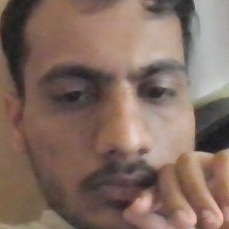

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:27:56] "POST / HTTP/1.1" 200 -


('Neutral', 0.5352900624275208)


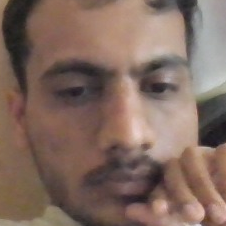

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:27:58] "POST / HTTP/1.1" 200 -


('Sad', 0.5403731465339661)


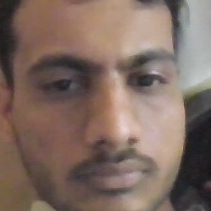

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:00] "POST / HTTP/1.1" 200 -


('Neutral', 0.5197983980178833)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:01] "GET / HTTP/1.1" 200 -


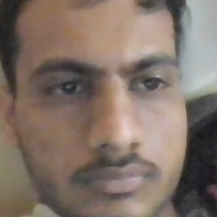

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:01] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:01] "GET /favicon.ico HTTP/1.1" 404 -


('Neutral', 0.6787658333778381)


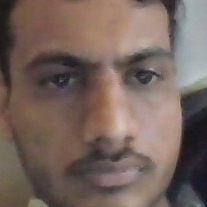

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:03] "POST / HTTP/1.1" 200 -


('Neutral', 0.8672996163368225)


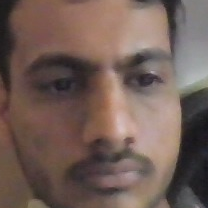

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:04] "POST / HTTP/1.1" 200 -


('Sad', 0.5385053753852844)


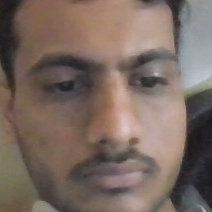

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:05] "POST / HTTP/1.1" 200 -


('Neutral', 0.7026274800300598)


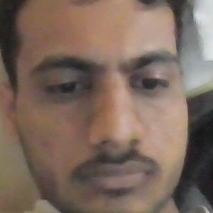

1/1 [==============================] - 0s 30ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:06] "POST / HTTP/1.1" 200 -


('Neutral', 0.6554919481277466)


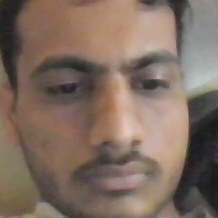

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:07] "POST / HTTP/1.1" 200 -


('Neutral', 0.6774159669876099)


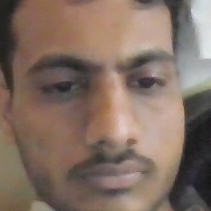

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:08] "POST / HTTP/1.1" 200 -


('Neutral', 0.7230789065361023)


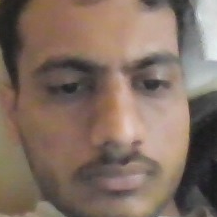

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:09] "POST / HTTP/1.1" 200 -


('Neutral', 0.7459495067596436)


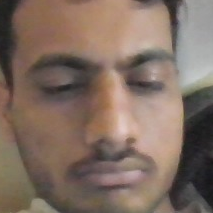

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:10] "POST / HTTP/1.1" 200 -


('Neutral', 0.571489691734314)


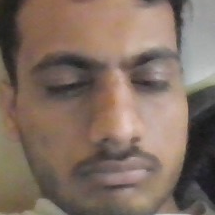

1/1 [==============================] - 0s 29ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:11] "POST / HTTP/1.1" 200 -


('Sad', 0.5065402388572693)


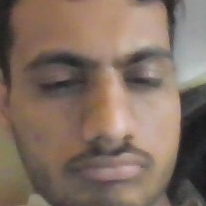

1/1 [==============================] - 0s 28ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:12] "POST / HTTP/1.1" 200 -


('Sad', 0.5665791630744934)


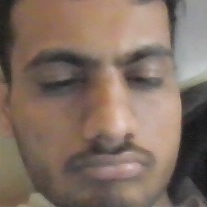

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:13] "POST / HTTP/1.1" 200 -


('Neutral', 0.577007532119751)


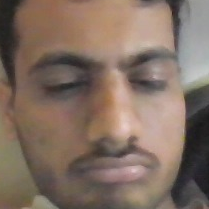

1/1 [==============================] - 0s 25ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:14] "POST / HTTP/1.1" 200 -


('Neutral', 0.6044058203697205)


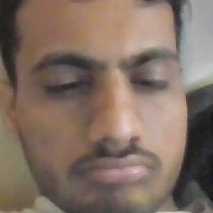

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:15] "POST / HTTP/1.1" 200 -


('Sad', 0.5363936424255371)


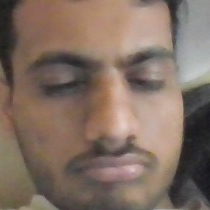

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:16] "POST / HTTP/1.1" 200 -


('Neutral', 0.621009349822998)


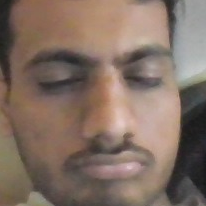

1/1 [==============================] - 0s 28ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:17] "POST / HTTP/1.1" 200 -


('Sad', 0.5628084540367126)


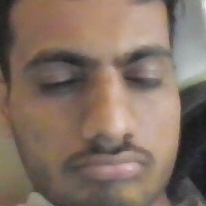

1/1 [==============================] - 0s 30ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:18] "POST / HTTP/1.1" 200 -


('Neutral', 0.6297854781150818)


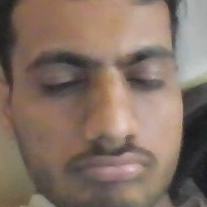

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:19] "POST / HTTP/1.1" 200 -


('Neutral', 0.693159282207489)


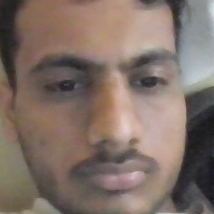

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:20] "POST / HTTP/1.1" 200 -


('Neutral', 0.8053395748138428)


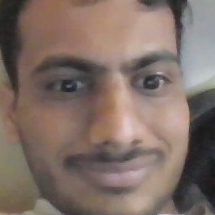

1/1 [==============================] - 0s 55ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:21] "POST / HTTP/1.1" 200 -


('Neutral', 0.7818920612335205)


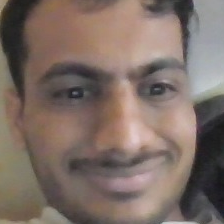

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:22] "POST / HTTP/1.1" 200 -


('Sad', 0.5092102289199829)


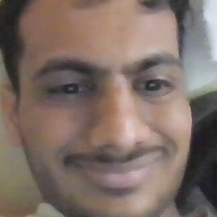

1/1 [==============================] - 0s 26ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:23] "POST / HTTP/1.1" 200 -


('Sad', 0.4804832339286804)


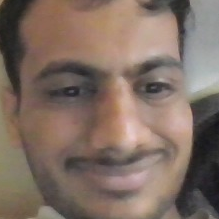

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:24] "POST / HTTP/1.1" 200 -


('Sad', 0.3770642876625061)


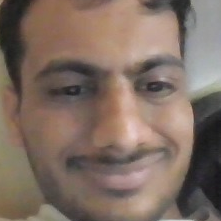

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:25] "POST / HTTP/1.1" 200 -


('Sad', 0.41490018367767334)


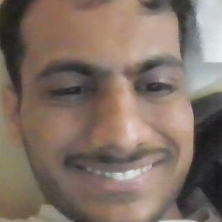

1/1 [==============================] - 0s 25ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:26] "POST / HTTP/1.1" 200 -


('Happy', 0.9312654137611389)


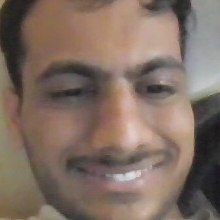

1/1 [==============================] - 0s 25ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:27] "POST / HTTP/1.1" 200 -


('Happy', 0.8967791795730591)


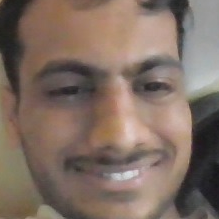

1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:28] "POST / HTTP/1.1" 200 -


('Happy', 0.8630200028419495)


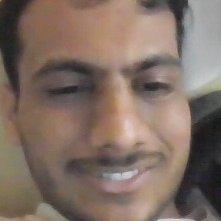

1/1 [==============================] - 0s 26ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:29] "POST / HTTP/1.1" 200 -


('Neutral', 0.40642377734184265)


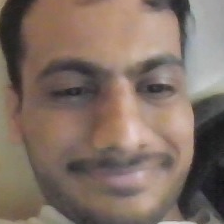

1/1 [==============================] - 0s 27ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:30] "POST / HTTP/1.1" 200 -


('Neutral', 0.5924167633056641)


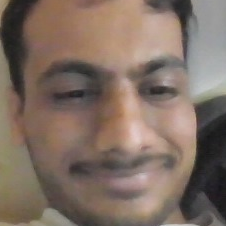

1/1 [==============================] - 0s 26ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:31] "POST / HTTP/1.1" 200 -


('Neutral', 0.5147581696510315)


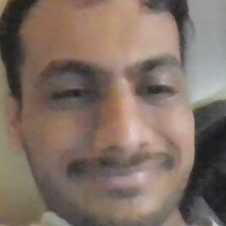

1/1 [==============================] - 0s 49ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:32] "POST / HTTP/1.1" 200 -


('Neutral', 0.4887457489967346)


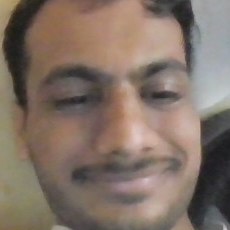

1/1 [==============================] - 0s 49ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:33] "POST / HTTP/1.1" 200 -


('Happy', 0.5008408427238464)


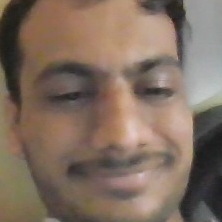

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:34] "POST / HTTP/1.1" 200 -


('Sad', 0.3458956778049469)


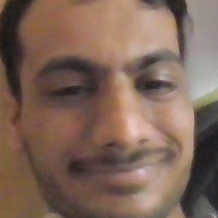

1/1 [==============================] - 0s 26ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:35] "POST / HTTP/1.1" 200 -


('Neutral', 0.46593162417411804)


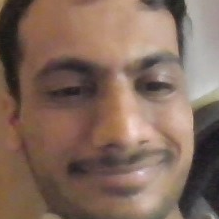

1/1 [==============================] - 0s 27ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:36] "POST / HTTP/1.1" 200 -


('Sad', 0.5896072387695312)


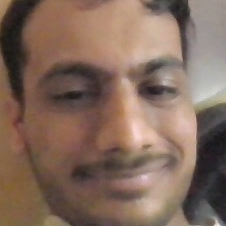

1/1 [==============================] - 0s 29ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:37] "POST / HTTP/1.1" 200 -


('Neutral', 0.5874327421188354)


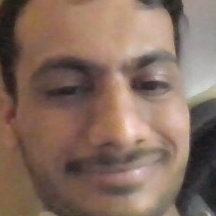

1/1 [==============================] - 0s 29ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:38] "POST / HTTP/1.1" 200 -


('Sad', 0.6527224183082581)


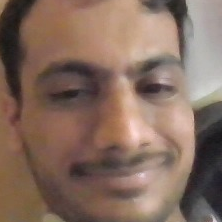

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:39] "POST / HTTP/1.1" 200 -


('Neutral', 0.614194929599762)


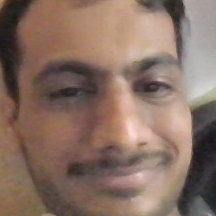

1/1 [==============================] - 0s 31ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:40] "POST / HTTP/1.1" 200 -


('Neutral', 0.630677342414856)


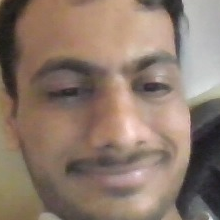

1/1 [==============================] - 0s 51ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:41] "POST / HTTP/1.1" 200 -


('Neutral', 0.5835672616958618)


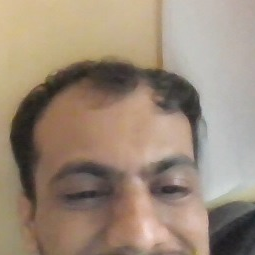

1/1 [==============================] - 0s 30ms/step
('Happy', 0.99664306640625)


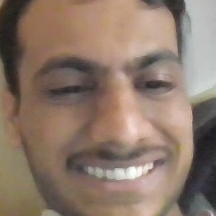

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:42] "POST / HTTP/1.1" 200 -


('Happy', 0.9992249011993408)


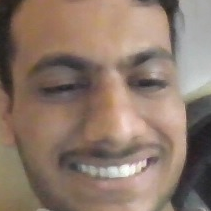

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:43] "POST / HTTP/1.1" 200 -


('Happy', 0.9798785448074341)


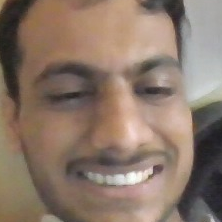

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:44] "POST / HTTP/1.1" 200 -


('Happy', 0.9964015483856201)


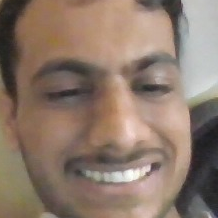

1/1 [==============================] - 0s 66ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:45] "POST / HTTP/1.1" 200 -


('Happy', 0.9903546571731567)


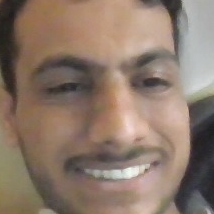

1/1 [==============================] - 0s 59ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:46] "POST / HTTP/1.1" 200 -


('Happy', 0.9406970739364624)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:46] "POST / HTTP/1.1" 200 -


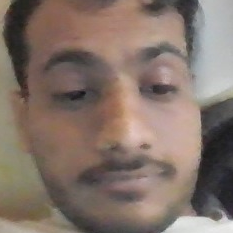

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:48] "POST / HTTP/1.1" 200 -


('Neutral', 0.8607443571090698)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:49] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:50] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:51] "POST / HTTP/1.1" 200 -


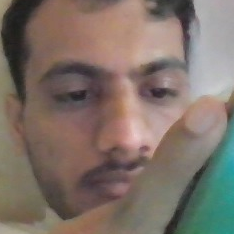

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:52] "POST / HTTP/1.1" 200 -


('Neutral', 0.5089190602302551)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:53] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:53] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:54] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:56] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:57] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:57] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:28:59] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:00] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:01] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:02] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:03] "POST / HTTP/1.1" 200 -


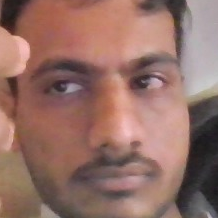

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:04] "POST / HTTP/1.1" 200 -


('Neutral', 0.9165894389152527)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:05] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:06] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:07] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:08] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:09] "POST / HTTP/1.1" 200 -


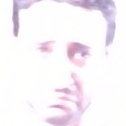

1/1 [==============================] - 0s 47ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:10] "POST / HTTP/1.1" 200 -


('Neutral', 0.8999236822128296)


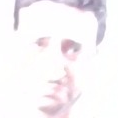

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:11] "POST / HTTP/1.1" 200 -


('Neutral', 0.7569897770881653)


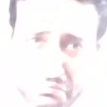

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:12] "POST / HTTP/1.1" 200 -


('Sad', 0.5459185242652893)


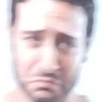

1/1 [==============================] - 0s 57ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:13] "POST / HTTP/1.1" 200 -


('Sad', 0.853441059589386)


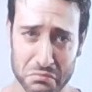

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:14] "POST / HTTP/1.1" 200 -


('Sad', 0.988051176071167)


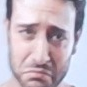

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:15] "POST / HTTP/1.1" 200 -


('Sad', 0.9786893725395203)


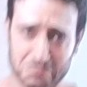

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:16] "POST / HTTP/1.1" 200 -


('Sad', 0.9347054958343506)


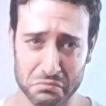

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:17] "POST / HTTP/1.1" 200 -


('Sad', 0.9501858949661255)


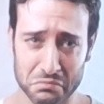

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:18] "POST / HTTP/1.1" 200 -


('Sad', 0.993117094039917)


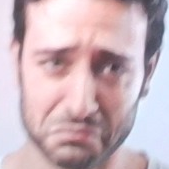

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:19] "POST / HTTP/1.1" 200 -


('Sad', 0.9815137982368469)


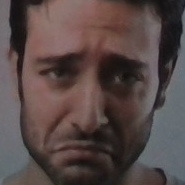

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:20] "POST / HTTP/1.1" 200 -


('Sad', 0.9429455995559692)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:20] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:22] "POST / HTTP/1.1" 200 -


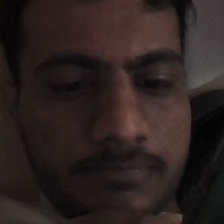

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:23] "POST / HTTP/1.1" 200 -


('Sad', 0.8881451487541199)


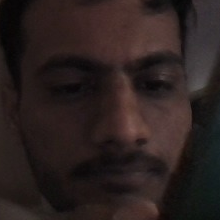

1/1 [==============================] - 0s 47ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:24] "POST / HTTP/1.1" 200 -


('Sad', 0.7330121397972107)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:25] "POST / HTTP/1.1" 200 -


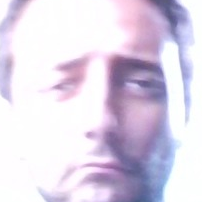

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:26] "POST / HTTP/1.1" 200 -


('Sad', 0.7808924913406372)


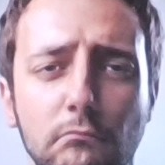

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:27] "POST / HTTP/1.1" 200 -


('Neutral', 0.8356401324272156)


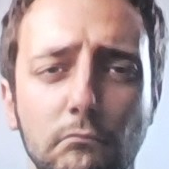

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:28] "POST / HTTP/1.1" 200 -


('Neutral', 0.8959299921989441)


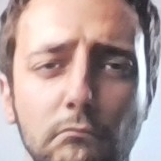

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:29] "POST / HTTP/1.1" 200 -


('Neutral', 0.7710996270179749)


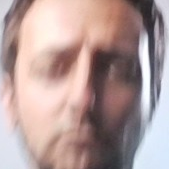

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:30] "POST / HTTP/1.1" 200 -


('Neutral', 0.9364857077598572)


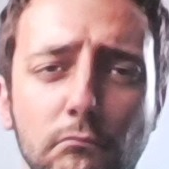

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:31] "POST / HTTP/1.1" 200 -


('Sad', 0.5805646777153015)


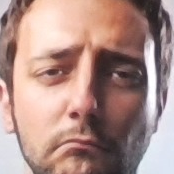

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:32] "POST / HTTP/1.1" 200 -


('Neutral', 0.7003464102745056)


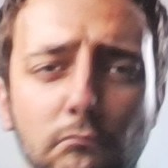

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:33] "POST / HTTP/1.1" 200 -


('Sad', 0.7046794891357422)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:33] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:34] "POST / HTTP/1.1" 200 -


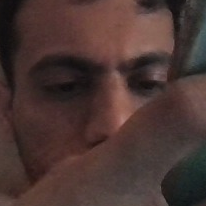

1/1 [==============================] - 0s 48ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:36] "POST / HTTP/1.1" 200 -


('Sad', 0.5214834213256836)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:37] "POST / HTTP/1.1" 200 -


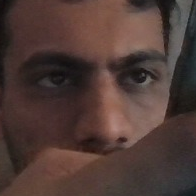

1/1 [==============================] - 0s 53ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:38] "POST / HTTP/1.1" 200 -


('Neutral', 0.5123580098152161)


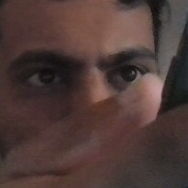

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:39] "POST / HTTP/1.1" 200 -


('Neutral', 0.858367919921875)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:40] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:41] "POST / HTTP/1.1" 200 -


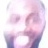

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:42] "POST / HTTP/1.1" 200 -


('Sad', 0.45609140396118164)


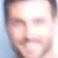

1/1 [==============================] - 0s 40ms/step
('Happy', 0.4829767048358917)


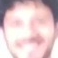

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:43] "POST / HTTP/1.1" 200 -


('Happy', 0.6722977757453918)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:44] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:45] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:46] "POST / HTTP/1.1" 200 -


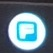

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:47] "POST / HTTP/1.1" 200 -


('Happy', 0.8910150527954102)


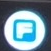

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:48] "POST / HTTP/1.1" 200 -


('Sad', 0.513211727142334)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:49] "POST / HTTP/1.1" 200 -


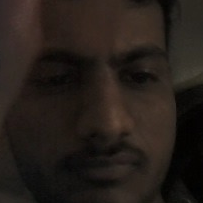

1/1 [==============================] - 0s 49ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:50] "POST / HTTP/1.1" 200 -


('Sad', 0.9367800951004028)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:51] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:52] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:53] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:53] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:55] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:56] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:57] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:58] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:29:59] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:00] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:01] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:02] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:03] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 -

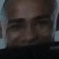

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:08] "POST / HTTP/1.1" 200 -


('Sad', 0.9566449522972107)


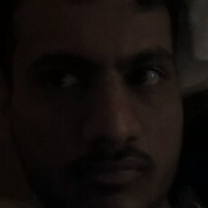

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:09] "POST / HTTP/1.1" 200 -


('Sad', 0.7227605581283569)


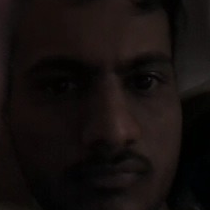

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:10] "POST / HTTP/1.1" 200 -


('Neutral', 0.5098093748092651)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:11] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:12] "POST / HTTP/1.1" 200 -


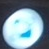

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:13] "POST / HTTP/1.1" 200 -


('Happy', 0.6583343744277954)


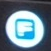

1/1 [==============================] - 0s 44ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:14] "POST / HTTP/1.1" 200 -


('Happy', 0.9990265369415283)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:15] "POST / HTTP/1.1" 200 -


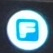

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:16] "POST / HTTP/1.1" 200 -


('Happy', 0.9735336899757385)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:17] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:18] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:19] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:20] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:21] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:22] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:23] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:24] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:25] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:26] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:27] "POST / HTTP/1.1" 200 -


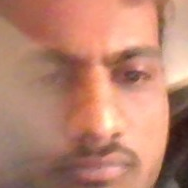

1/1 [==============================] - 0s 48ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:28] "POST / HTTP/1.1" 200 -


('Sad', 0.7242857813835144)


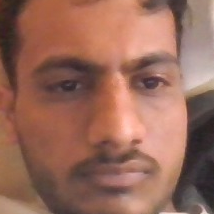

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:29] "POST / HTTP/1.1" 200 -


('Neutral', 0.687114953994751)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:30] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:31] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:32] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:33] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:34] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:35] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:36] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:37] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:38] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:39] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:40] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:41] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:42] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 -

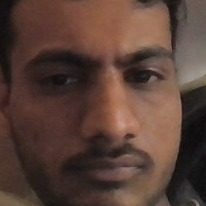

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:47] "POST / HTTP/1.1" 200 -


('Sad', 0.8410989046096802)


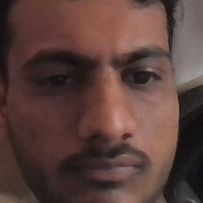

1/1 [==============================] - 0s 43ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:48] "POST / HTTP/1.1" 200 -


('Sad', 0.8072953820228577)


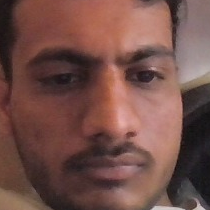

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:49] "POST / HTTP/1.1" 200 -


('Sad', 0.8159602284431458)


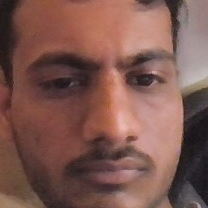

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:50] "POST / HTTP/1.1" 200 -


('Neutral', 0.6057472229003906)


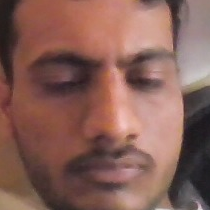

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:51] "POST / HTTP/1.1" 200 -


('Neutral', 0.5831436514854431)


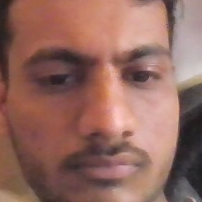

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:52] "POST / HTTP/1.1" 200 -


('Sad', 0.7626047730445862)


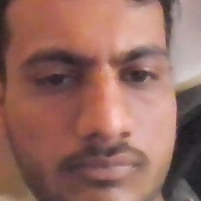

1/1 [==============================] - 0s 44ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:53] "POST / HTTP/1.1" 200 -


('Sad', 0.7248005867004395)


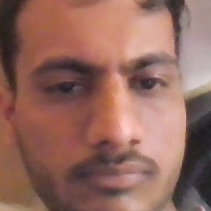

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:54] "POST / HTTP/1.1" 200 -


('Neutral', 0.6623077392578125)


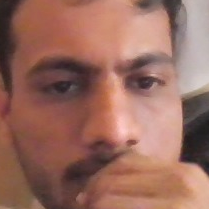

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:55] "POST / HTTP/1.1" 200 -


('Neutral', 0.5112412571907043)


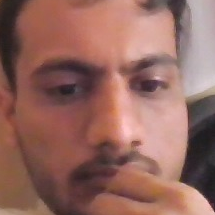

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:56] "POST / HTTP/1.1" 200 -


('Sad', 0.5680642127990723)


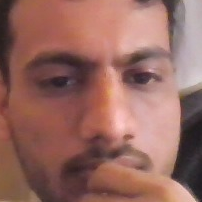

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:57] "POST / HTTP/1.1" 200 -


('Neutral', 0.5142642259597778)


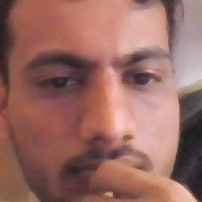

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:58] "POST / HTTP/1.1" 200 -


('Neutral', 0.5535851120948792)


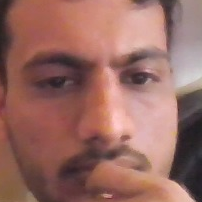

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:30:59] "POST / HTTP/1.1" 200 -


('Sad', 0.6719750761985779)


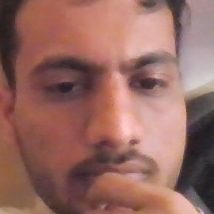

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:00] "POST / HTTP/1.1" 200 -


('Neutral', 0.6262704133987427)


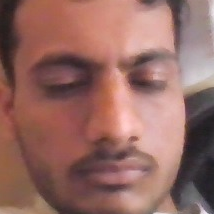

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:01] "POST / HTTP/1.1" 200 -


('Sad', 0.5450296998023987)


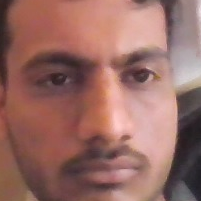

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:02] "POST / HTTP/1.1" 200 -


('Neutral', 0.773690938949585)


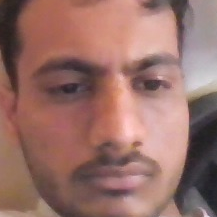

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:03] "POST / HTTP/1.1" 200 -


('Neutral', 0.8054420948028564)


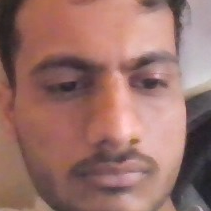

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:04] "POST / HTTP/1.1" 200 -


('Neutral', 0.577317476272583)


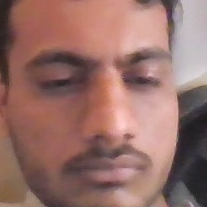

1/1 [==============================] - 0s 51ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:05] "POST / HTTP/1.1" 200 -


('Sad', 0.6293407678604126)


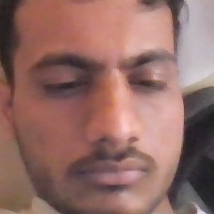

1/1 [==============================] - 0s 83ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:06] "POST / HTTP/1.1" 200 -


('Sad', 0.7896605134010315)


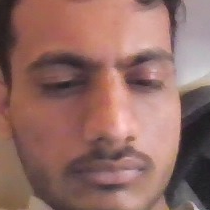

1/1 [==============================] - 0s 49ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:07] "POST / HTTP/1.1" 200 -


('Sad', 0.6265688538551331)


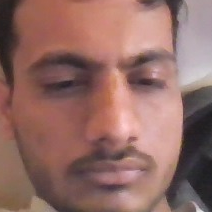

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:08] "POST / HTTP/1.1" 200 -


('Sad', 0.7863976359367371)


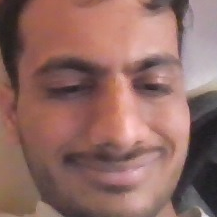

1/1 [==============================] - 0s 54ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:09] "POST / HTTP/1.1" 200 -


('Sad', 0.5069997906684875)


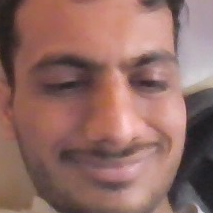

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:10] "POST / HTTP/1.1" 200 -


('Sad', 0.9533014893531799)


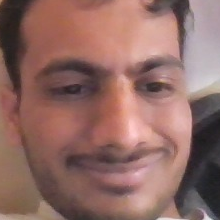

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:11] "POST / HTTP/1.1" 200 -


('Sad', 0.4624331593513489)


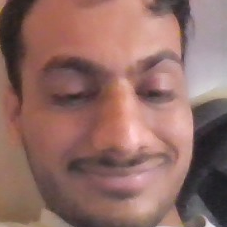

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:12] "POST / HTTP/1.1" 200 -


('Neutral', 0.42593148350715637)


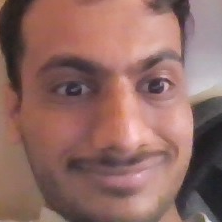

1/1 [==============================] - 0s 42ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:13] "POST / HTTP/1.1" 200 -


('Neutral', 0.9648960828781128)


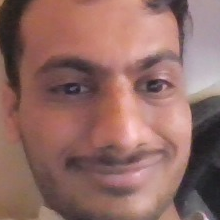

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:14] "POST / HTTP/1.1" 200 -


('Neutral', 0.8392606973648071)


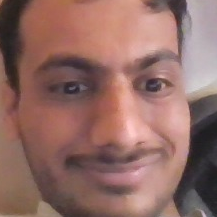

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:15] "POST / HTTP/1.1" 200 -


('Neutral', 0.7511502504348755)


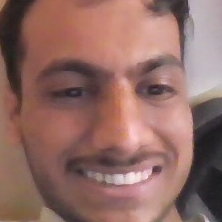

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:16] "POST / HTTP/1.1" 200 -


('Happy', 0.9673516154289246)


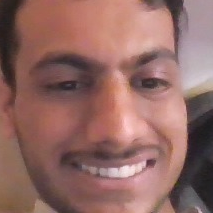

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:17] "POST / HTTP/1.1" 200 -


('Happy', 0.9728035926818848)


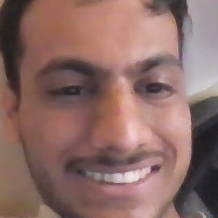

1/1 [==============================] - 0s 59ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:18] "POST / HTTP/1.1" 200 -


('Happy', 0.9867690801620483)


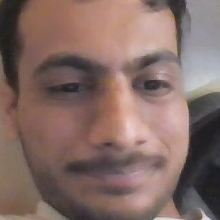

1/1 [==============================] - 0s 54ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:19] "POST / HTTP/1.1" 200 -


('Sad', 0.6151254773139954)


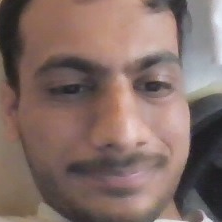

1/1 [==============================] - 0s 49ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:20] "POST / HTTP/1.1" 200 -


('Neutral', 0.5717655420303345)


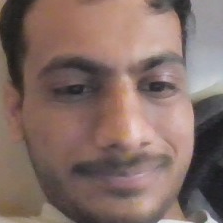

1/1 [==============================] - 0s 72ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:21] "POST / HTTP/1.1" 200 -


('Neutral', 0.6805614829063416)


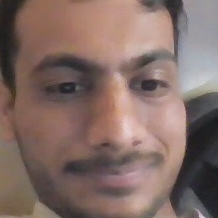

1/1 [==============================] - 0s 51ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:22] "POST / HTTP/1.1" 200 -


('Neutral', 0.5254874229431152)


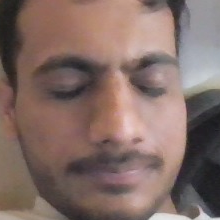

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:23] "POST / HTTP/1.1" 200 -


('Sad', 0.5799881815910339)


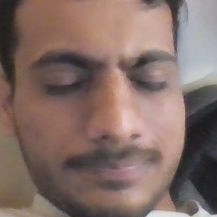

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:24] "POST / HTTP/1.1" 200 -


('Sad', 0.6313909888267517)


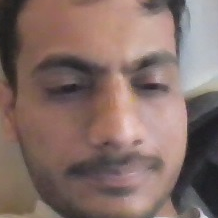

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:25] "POST / HTTP/1.1" 200 -


('Sad', 0.5197372436523438)


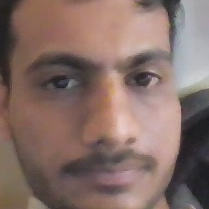

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:26] "POST / HTTP/1.1" 200 -


('Neutral', 0.7555794715881348)


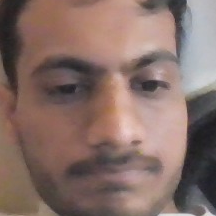

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:27] "POST / HTTP/1.1" 200 -


('Neutral', 0.5841313600540161)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:27] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:28] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:29] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:30] "POST / HTTP/1.1" 200 -


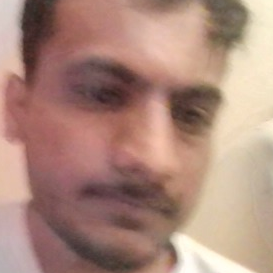

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:32] "POST / HTTP/1.1" 200 -


('Sad', 0.9304582476615906)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:32] "POST / HTTP/1.1" 200 -


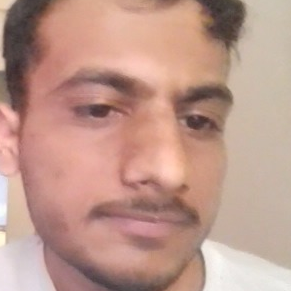

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:34] "POST / HTTP/1.1" 200 -


('Sad', 0.5696929693222046)


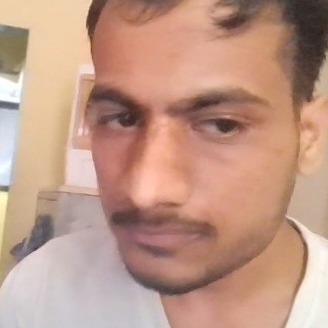

1/1 [==============================] - 0s 36ms/step
('Neutral', 0.6054571270942688)


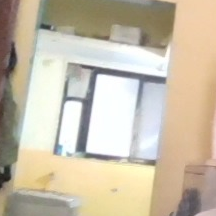

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:35] "POST / HTTP/1.1" 200 -


('Neutral', 0.6334030628204346)


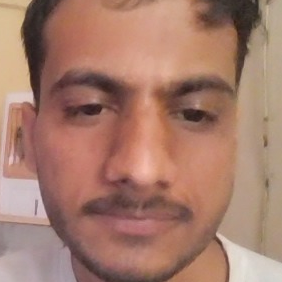

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:36] "POST / HTTP/1.1" 200 -


('Neutral', 0.6234237551689148)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:37] "POST / HTTP/1.1" 200 -


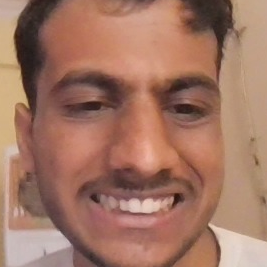

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:38] "POST / HTTP/1.1" 200 -


('Happy', 0.9178181290626526)


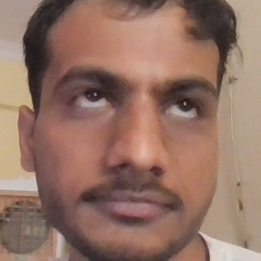

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:39] "POST / HTTP/1.1" 200 -


('Neutral', 0.9248095750808716)


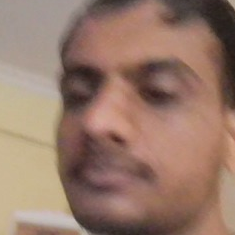

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:40] "POST / HTTP/1.1" 200 -


('Sad', 0.7373091578483582)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:41] "POST / HTTP/1.1" 200 -


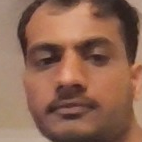

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:42] "POST / HTTP/1.1" 200 -


('Neutral', 0.8018774390220642)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:42] "POST / HTTP/1.1" 200 -


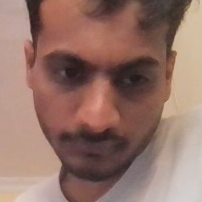

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:44] "POST / HTTP/1.1" 200 -


('Sad', 0.6933557391166687)


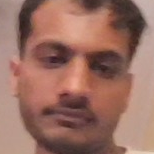

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:45] "POST / HTTP/1.1" 200 -


('Sad', 0.6986197233200073)


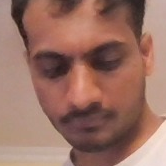

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:46] "POST / HTTP/1.1" 200 -


('Sad', 0.9321039319038391)


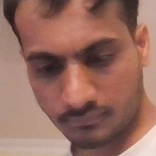

1/1 [==============================] - 0s 56ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:47] "POST / HTTP/1.1" 200 -


('Sad', 0.8620167970657349)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:47] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:49] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:49] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:50] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:51] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:52] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:53] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:54] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:55] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:56] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:57] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:58] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:31:59] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 -

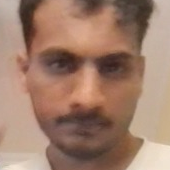

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:07] "POST / HTTP/1.1" 200 -


('Sad', 0.7642234563827515)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:07] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:08] "POST / HTTP/1.1" 200 -


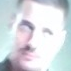

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:10] "POST / HTTP/1.1" 200 -


('Neutral', 0.8820278644561768)


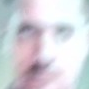

1/1 [==============================] - 0s 37ms/step
('Sad', 0.6246464848518372)


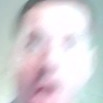

1/1 [==============================] - 0s 48ms/step
('Neutral', 0.7698241472244263)


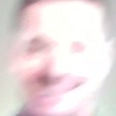

1/1 [==============================] - 0s 69ms/step
('Happy', 0.8666995167732239)


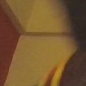

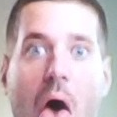

1/1 [==============================] - 0s 74ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:12] "POST / HTTP/1.1" 200 -


('Sad', 0.532429039478302)
1/1 [==============================] - 0s 50ms/step
('Neutral', 0.7565484642982483)


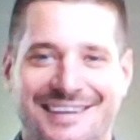

1/1 [==============================] - 0s 56ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:13] "POST / HTTP/1.1" 200 -


('Happy', 0.9996261596679688)


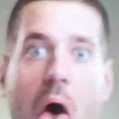

1/1 [==============================] - 0s 35ms/step
('Neutral', 0.8915924429893494)


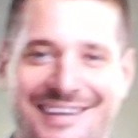

1/1 [==============================] - 0s 60ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:14] "POST / HTTP/1.1" 200 -


('Happy', 0.9999861717224121)


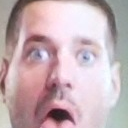

1/1 [==============================] - 0s 53ms/step
('Neutral', 0.849046528339386)


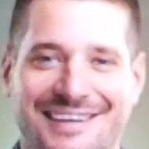

1/1 [==============================] - 0s 55ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:14] "POST / HTTP/1.1" 200 -


('Happy', 0.9993878602981567)


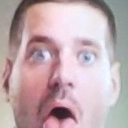

1/1 [==============================] - 0s 35ms/step
('Neutral', 0.5709766745567322)


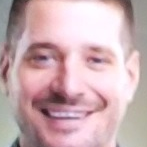

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:15] "POST / HTTP/1.1" 200 -


('Happy', 0.994114100933075)


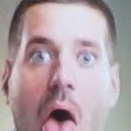

1/1 [==============================] - 0s 48ms/step
('Sad', 0.5211949944496155)


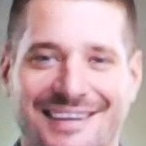

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:16] "POST / HTTP/1.1" 200 -


('Happy', 0.9994267225265503)


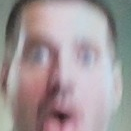

1/1 [==============================] - 0s 34ms/step
('Sad', 0.5097106099128723)


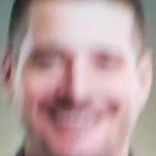

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:17] "POST / HTTP/1.1" 200 -


('Happy', 0.9936603903770447)


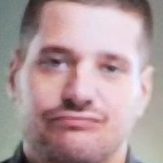

1/1 [==============================] - 0s 34ms/step
('Neutral', 0.930780291557312)


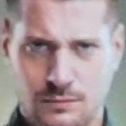

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:18] "POST / HTTP/1.1" 200 -


('Neutral', 0.7751753330230713)


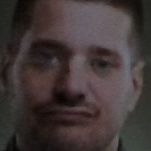

1/1 [==============================] - 0s 35ms/step
('Neutral', 0.7026953101158142)


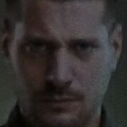

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:19] "POST / HTTP/1.1" 200 -


('Sad', 0.7951251864433289)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:19] "POST / HTTP/1.1" 200 -


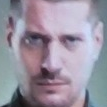

1/1 [==============================] - 0s 35ms/step
('Neutral', 0.600338339805603)


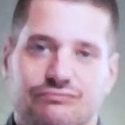

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:21] "POST / HTTP/1.1" 200 -


('Neutral', 0.9527600407600403)


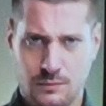

1/1 [==============================] - 0s 36ms/step
('Neutral', 0.5932204127311707)


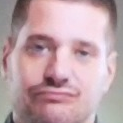

1/1 [==============================] - 0s 52ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:22] "POST / HTTP/1.1" 200 -


('Neutral', 0.9403513073921204)


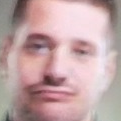

1/1 [==============================] - 0s 35ms/step
('Neutral', 0.8810421824455261)


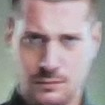

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:23] "POST / HTTP/1.1" 200 -


('Neutral', 0.5208021998405457)


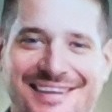

1/1 [==============================] - 0s 36ms/step
('Happy', 0.9998759031295776)


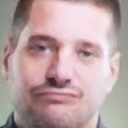

1/1 [==============================] - 0s 38ms/step
('Neutral', 0.9168426990509033)


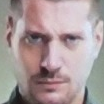

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:24] "POST / HTTP/1.1" 200 -


('Sad', 0.6958487033843994)


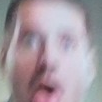

1/1 [==============================] - 0s 40ms/step
('Happy', 0.39193961024284363)


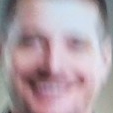

1/1 [==============================] - 0s 37ms/step
('Happy', 0.9909062385559082)


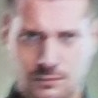

1/1 [==============================] - 0s 37ms/step
('Neutral', 0.7101801633834839)


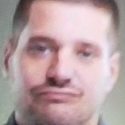

1/1 [==============================] - 0s 36ms/step


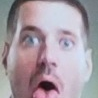

1/1 [==============================] - 0s 93ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:26] "POST / HTTP/1.1" 200 -


('Neutral', 0.9239317178726196)
1/1 [==============================] - 0s 34ms/step
('Neutral', 0.5611198544502258)


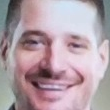

1/1 [==============================] - 0s 41ms/step
('Happy', 0.9998600482940674)


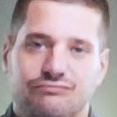

1/1 [==============================] - 0s 39ms/step
('Neutral', 0.9675199389457703)


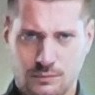

1/1 [==============================] - 0s 35ms/step


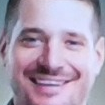

1/1 [==============================] - 0s 76ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:27] "POST / HTTP/1.1" 200 -


('Neutral', 0.6041507720947266)
1/1 [==============================] - 0s 60ms/step
('Happy', 0.9986242055892944)


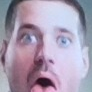

1/1 [==============================] - 0s 46ms/step
('Neutral', 0.6484067440032959)


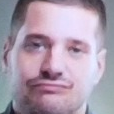

1/1 [==============================] - 0s 86ms/step
('Neutral', 0.9090389609336853)


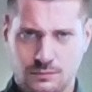

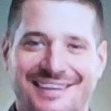

1/1 [==============================] - 0s 90ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:29] "POST / HTTP/1.1" 200 -


('Sad', 0.5385771989822388)
1/1 [==============================] - 0s 83ms/step
('Happy', 0.9995191097259521)


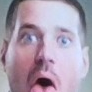

1/1 [==============================] - 0s 78ms/step
('Neutral', 0.7638241648674011)


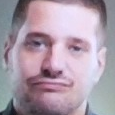

1/1 [==============================] - 0s 56ms/step


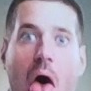

1/1 [==============================] - 0s 89ms/step
('Neutral', 0.9318196773529053)


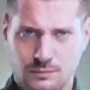

1/1 [==============================] - 0s 197ms/step
('Neutral', 0.5003087520599365)


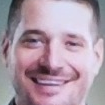

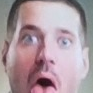

1/1 [==============================] - 0s 148ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:30] "POST / HTTP/1.1" 200 -


('Sad', 0.5454810261726379)
1/1 [==============================] - 0s 129ms/step
('Neutral', 0.7009968757629395)


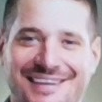

1/1 [==============================] - 0s 131ms/step
('Happy', 0.9998577833175659)


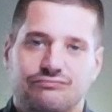

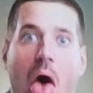

1/1 [==============================] - 0s 82ms/step
('Happy', 0.9997333884239197)


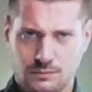

1/1 [==============================] - 0s 143ms/step
('Neutral', 0.9136398434638977)


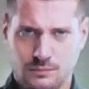

1/1 [==============================] - 0s 165ms/step
('Neutral', 0.5055553317070007)


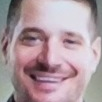

1/1 [==============================] - 0s 201ms/step


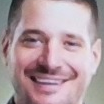

1/1 [==============================] - 0s 193ms/step
('Neutral', 0.5080261826515198)


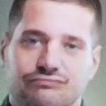

INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:33] "POST / HTTP/1.1" 200 -


('Neutral', 0.7172210812568665)
1/1 [==============================] - 0s 187ms/step
('Happy', 0.9968245029449463)


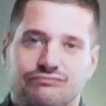

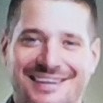

1/1 [==============================] - 0s 188ms/step
('Happy', 0.9997475743293762)


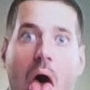

1/1 [==============================] - 0s 149ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:34] "POST / HTTP/1.1" 200 -


('Neutral', 0.9277300834655762)


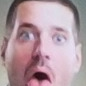

1/1 [==============================] - 0s 160ms/step
('Neutral', 0.9450514316558838)


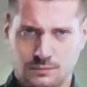

1/1 [==============================] - 0s 158ms/step
('Happy', 0.9993458390235901)


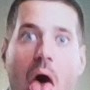

1/1 [==============================] - 0s 170ms/step
('Neutral', 0.570320725440979)


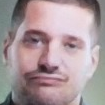

1/1 [==============================] - 0s 193ms/step


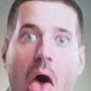

1/1 [==============================] - 0s 260ms/step
('Neutral', 0.5892752408981323)


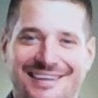

1/1 [==============================] - 0s 239ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:36] "POST / HTTP/1.1" 200 -


('Neutral', 0.6866655945777893)
1/1 [==============================] - 0s 232ms/step
('Sad', 0.5156492590904236)
1/1 [==============================] - ETA: 0s

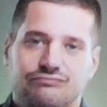

1/1 [==============================] - 0s 272ms/step


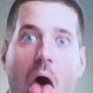

1/1 [==============================] - 0s 200ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:37] "POST / HTTP/1.1" 200 -


1/1 [==============================] - 0s 245ms/step
('Neutral', 0.9036444425582886)


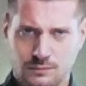

1/1 [==============================] - 0s 205ms/step
('Neutral', 0.5149126648902893)


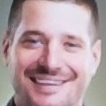

1/1 [==============================] - 0s 241ms/step
('Happy', 0.9998905658721924)


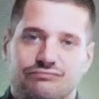

1/1 [==============================] - 0s 165ms/step
('Neutral', 0.9577153921127319)


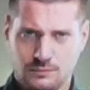

1/1 [==============================] - 0s 176ms/step
('Neutral', 0.6081222295761108)


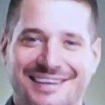

1/1 [==============================] - 0s 262ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:38] "POST / HTTP/1.1" 200 -


1/1 [==============================] - 0s 180ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:38] "POST / HTTP/1.1" 200 -


('Sad', 0.661013126373291)
1/1 [==============================] - 0s 176ms/step
('Happy', 0.999941349029541)


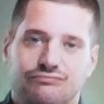

1/1 [==============================] - 0s 165ms/step
('Neutral', 0.9374958872795105)


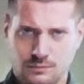

1/1 [==============================] - 0s 163ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:38] "POST / HTTP/1.1" 200 -


('Neutral', 0.7082459330558777)
1/1 [==============================] - 0s 113ms/step
('Happy', 0.9975706934928894)


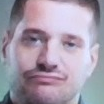

1/1 [==============================] - 0s 127ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:39] "POST / HTTP/1.1" 200 -


1/1 [==============================] - 0s 133ms/step
('Neutral', 0.9244663715362549)


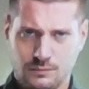

1/1 [==============================] - 0s 147ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:39] "POST / HTTP/1.1" 200 -


('Sad', 0.5145182609558105)
1/1 [==============================] - 0s 82ms/step
('Neutral', 0.9646605253219604)


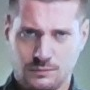

1/1 [==============================] - 0s 77ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:40] "POST / HTTP/1.1" 200 -


('Neutral', 0.6867504119873047)
1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:40] "POST / HTTP/1.1" 200 -


('Neutral', 0.7018986344337463)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:40] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:41] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:42] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:43] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:44] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:45] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:46] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:47] "POST / HTTP/1.1" 200 -


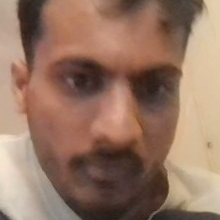

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:48] "POST / HTTP/1.1" 200 -


('Sad', 0.7393051981925964)


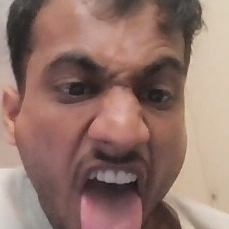

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:49] "POST / HTTP/1.1" 200 -


('Neutral', 0.6052772998809814)


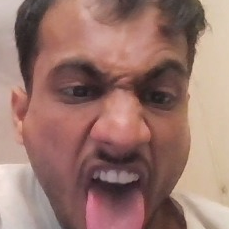

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:50] "POST / HTTP/1.1" 200 -


('Happy', 0.7711183428764343)


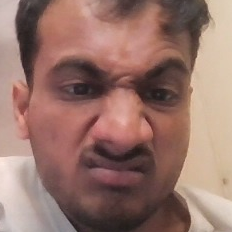

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:51] "POST / HTTP/1.1" 200 -


('Sad', 0.7739396691322327)


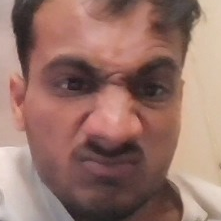

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:52] "POST / HTTP/1.1" 200 -


('Sad', 0.6540905237197876)


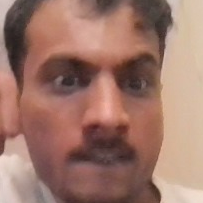

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:53] "POST / HTTP/1.1" 200 -


('Neutral', 0.6683014631271362)


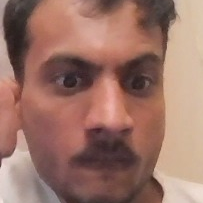

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:54] "POST / HTTP/1.1" 200 -


('Neutral', 0.7220979928970337)


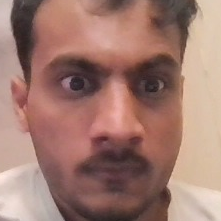

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:55] "POST / HTTP/1.1" 200 -


('Neutral', 0.8352200984954834)


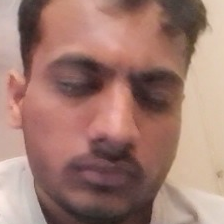

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:56] "POST / HTTP/1.1" 200 -


('Sad', 0.9589217305183411)


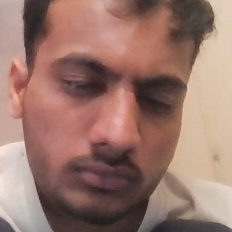

1/1 [==============================] - 0s 60ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:57] "POST / HTTP/1.1" 200 -


('Sad', 0.8635969758033752)


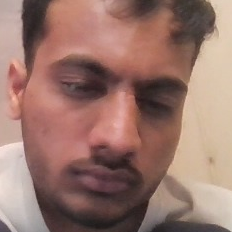

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:58] "POST / HTTP/1.1" 200 -


('Sad', 0.8343939781188965)


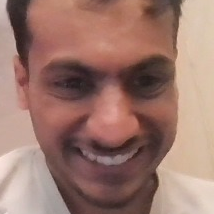

1/1 [==============================] - 0s 63ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:32:59] "POST / HTTP/1.1" 200 -


('Happy', 0.9984544515609741)


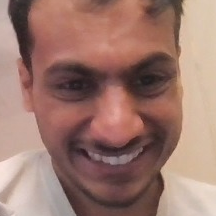

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:00] "POST / HTTP/1.1" 200 -


('Happy', 0.9998965263366699)


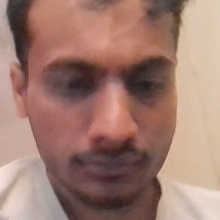

1/1 [==============================] - 0s 70ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:01] "POST / HTTP/1.1" 200 -


('Sad', 0.8290585875511169)


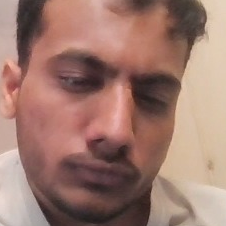

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:02] "POST / HTTP/1.1" 200 -


('Sad', 0.7844295501708984)


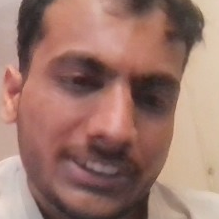

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:03] "POST / HTTP/1.1" 200 -


('Sad', 0.7292572259902954)


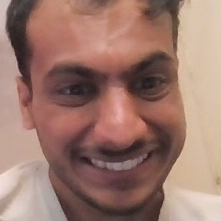

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:04] "POST / HTTP/1.1" 200 -


('Happy', 0.9954517483711243)


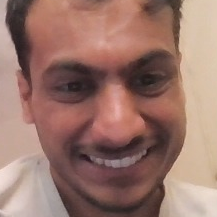

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:05] "POST / HTTP/1.1" 200 -


('Happy', 0.9996174573898315)


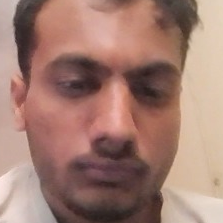

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:06] "POST / HTTP/1.1" 200 -


('Sad', 0.8018253445625305)


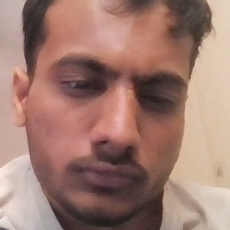

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:07] "POST / HTTP/1.1" 200 -


('Sad', 0.9200888276100159)


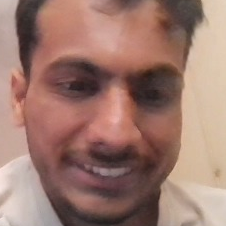

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:08] "POST / HTTP/1.1" 200 -


('Happy', 0.4687402844429016)


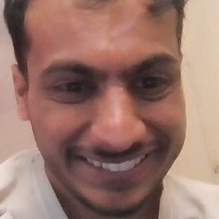

1/1 [==============================] - 0s 44ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:09] "POST / HTTP/1.1" 200 -


('Happy', 0.9609419107437134)


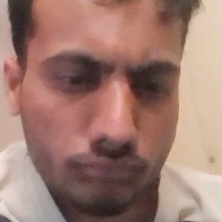

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:10] "POST / HTTP/1.1" 200 -


('Sad', 0.8557186126708984)


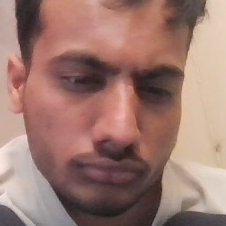

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:11] "POST / HTTP/1.1" 200 -


('Sad', 0.8659543395042419)


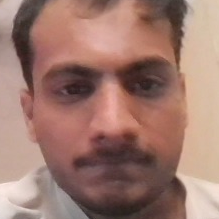

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:12] "POST / HTTP/1.1" 200 -


('Sad', 0.6101239919662476)


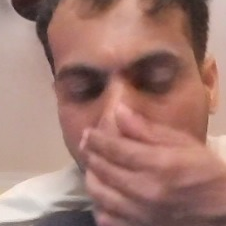

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:13] "POST / HTTP/1.1" 200 -


('Sad', 0.9141504168510437)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:14] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:15] "POST / HTTP/1.1" 200 -


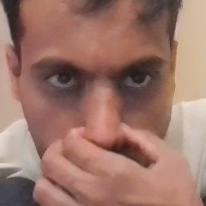

1/1 [==============================] - 0s 44ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:16] "POST / HTTP/1.1" 200 -


('Sad', 0.9241100549697876)


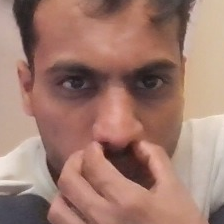

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:17] "POST / HTTP/1.1" 200 -


('Sad', 0.9656757712364197)


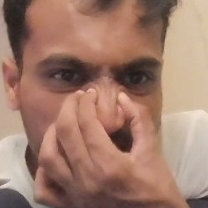

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:18] "POST / HTTP/1.1" 200 -


('Sad', 0.7711508870124817)


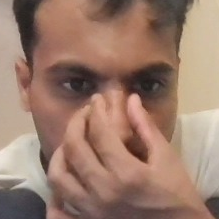

1/1 [==============================] - 0s 49ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:19] "POST / HTTP/1.1" 200 -


('Neutral', 0.5085045695304871)


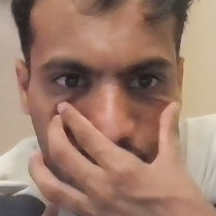

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:20] "POST / HTTP/1.1" 200 -


('Sad', 0.8635051250457764)


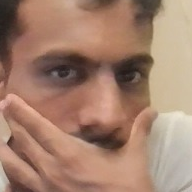

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:21] "POST / HTTP/1.1" 200 -


('Happy', 0.4320664405822754)


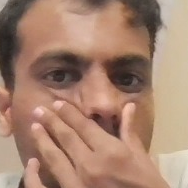

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:22] "POST / HTTP/1.1" 200 -


('Sad', 0.9625723361968994)


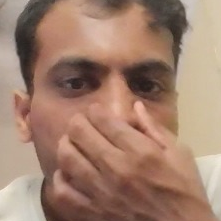

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:23] "POST / HTTP/1.1" 200 -


('Sad', 0.9414958953857422)


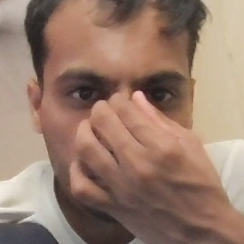

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:24] "POST / HTTP/1.1" 200 -


('Sad', 0.7124559879302979)


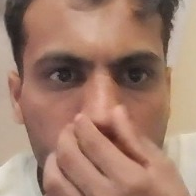

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:25] "POST / HTTP/1.1" 200 -


('Neutral', 0.5514107942581177)


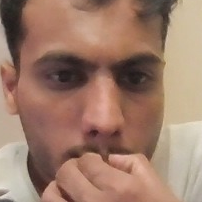

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:26] "POST / HTTP/1.1" 200 -


('Sad', 0.8011423945426941)


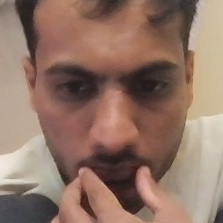

1/1 [==============================] - 0s 50ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:27] "POST / HTTP/1.1" 200 -


('Sad', 0.9425049424171448)


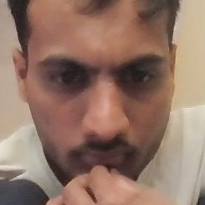

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:28] "POST / HTTP/1.1" 200 -


('Sad', 0.86168372631073)


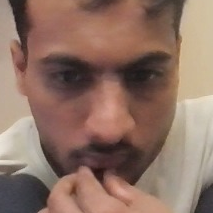

1/1 [==============================] - 0s 53ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:29] "POST / HTTP/1.1" 200 -


('Sad', 0.92156583070755)


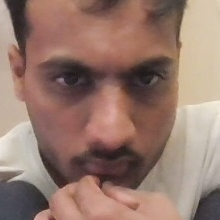

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:30] "POST / HTTP/1.1" 200 -


('Sad', 0.6021795272827148)


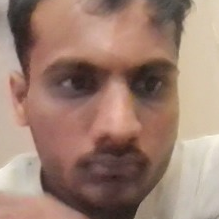

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:31] "POST / HTTP/1.1" 200 -


('Sad', 0.5594900846481323)


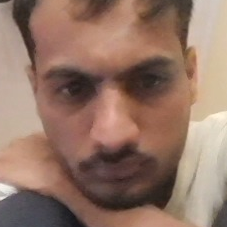

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:32] "POST / HTTP/1.1" 200 -


('Sad', 0.8647041916847229)


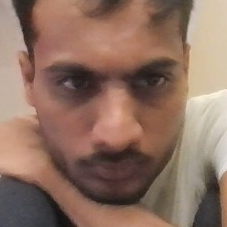

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:33] "POST / HTTP/1.1" 200 -


('Sad', 0.7710726857185364)


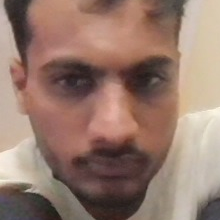

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:34] "POST / HTTP/1.1" 200 -


('Sad', 0.8312207460403442)


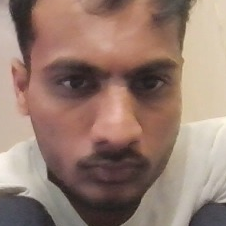

1/1 [==============================] - 0s 42ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:35] "POST / HTTP/1.1" 200 -


('Sad', 0.7669491767883301)


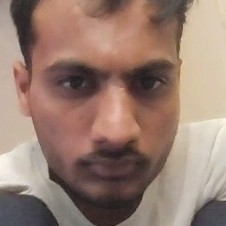

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:36] "POST / HTTP/1.1" 200 -


('Sad', 0.9521923661231995)


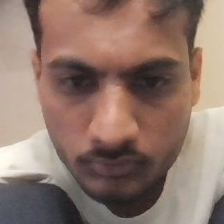

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:37] "POST / HTTP/1.1" 200 -


('Sad', 0.9071142673492432)


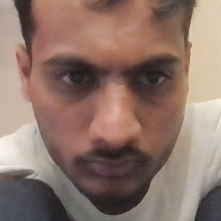

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:38] "POST / HTTP/1.1" 200 -


('Sad', 0.8065481185913086)


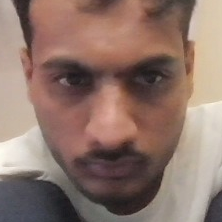

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:39] "POST / HTTP/1.1" 200 -


('Sad', 0.6517271399497986)


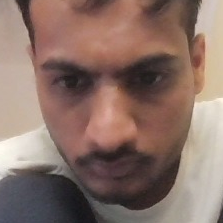

1/1 [==============================] - 0s 44ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:40] "POST / HTTP/1.1" 200 -


('Sad', 0.932381272315979)


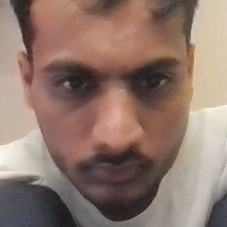

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:41] "POST / HTTP/1.1" 200 -


('Sad', 0.8079169988632202)


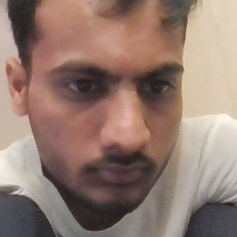

1/1 [==============================] - 0s 50ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:42] "POST / HTTP/1.1" 200 -


('Sad', 0.9278476238250732)


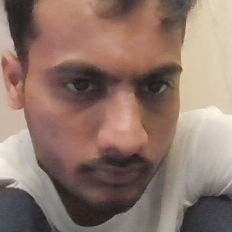

1/1 [==============================] - 0s 47ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:43] "POST / HTTP/1.1" 200 -


('Neutral', 0.6248654723167419)


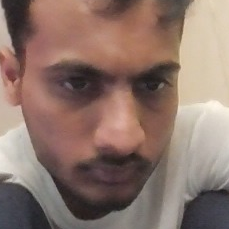

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:44] "POST / HTTP/1.1" 200 -


('Sad', 0.8216525316238403)


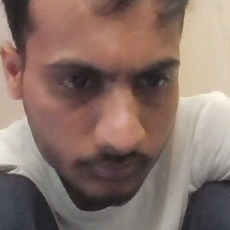

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:45] "POST / HTTP/1.1" 200 -


('Sad', 0.8166272044181824)


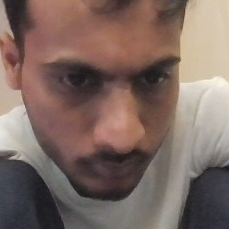

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:46] "POST / HTTP/1.1" 200 -


('Sad', 0.8661223649978638)


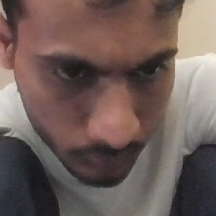

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:47] "POST / HTTP/1.1" 200 -


('Sad', 0.9565468430519104)


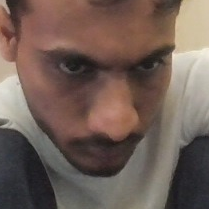

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:48] "POST / HTTP/1.1" 200 -


('Sad', 0.919363796710968)


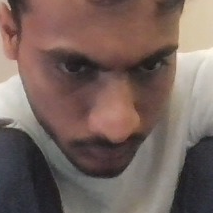

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:49] "POST / HTTP/1.1" 200 -


('Sad', 0.9596527814865112)


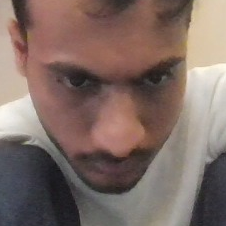

1/1 [==============================] - 0s 46ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:50] "POST / HTTP/1.1" 200 -


('Sad', 0.8428438305854797)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:51] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:52] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:53] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:54] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:55] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:56] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:57] "POST / HTTP/1.1" 200 -


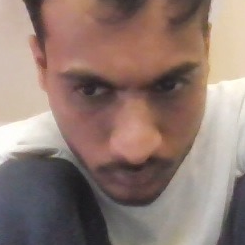

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:58] "POST / HTTP/1.1" 200 -


('Sad', 0.959767758846283)


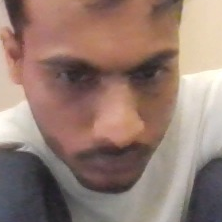

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:33:59] "POST / HTTP/1.1" 200 -


('Sad', 0.9580042362213135)


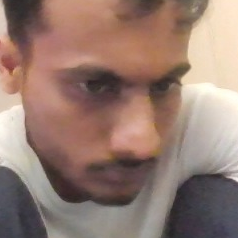

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:00] "POST / HTTP/1.1" 200 -


('Sad', 0.8267107009887695)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:01] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:02] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:03] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:04] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:05] "POST / HTTP/1.1" 200 -


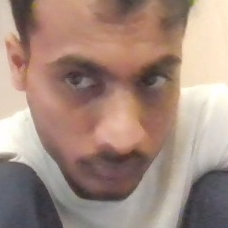

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:06] "POST / HTTP/1.1" 200 -


('Sad', 0.507530152797699)


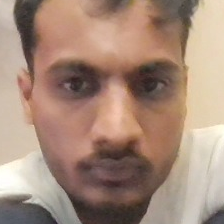

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:07] "POST / HTTP/1.1" 200 -


('Sad', 0.7099087238311768)


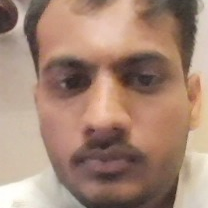

1/1 [==============================] - 0s 66ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:08] "POST / HTTP/1.1" 200 -


('Neutral', 0.6802762150764465)


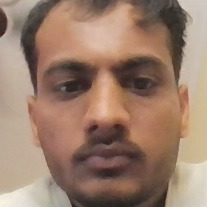

1/1 [==============================] - 0s 45ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:09] "POST / HTTP/1.1" 200 -


('Neutral', 0.5166687965393066)


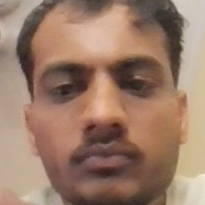

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:10] "POST / HTTP/1.1" 200 -


('Neutral', 0.6483355164527893)


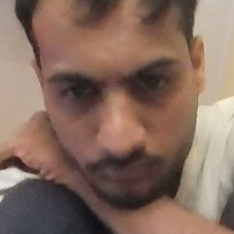

1/1 [==============================] - 0s 60ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:11] "POST / HTTP/1.1" 200 -


('Sad', 0.8309446573257446)


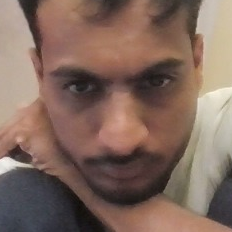

1/1 [==============================] - 0s 54ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:12] "POST / HTTP/1.1" 200 -


('Sad', 0.9069350957870483)


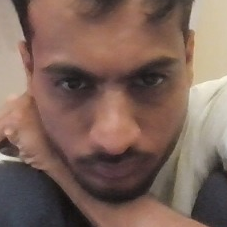

1/1 [==============================] - 0s 60ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:13] "POST / HTTP/1.1" 200 -


('Sad', 0.8617531061172485)


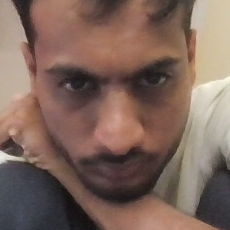

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:14] "POST / HTTP/1.1" 200 -


('Sad', 0.9492748379707336)


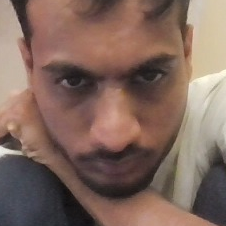

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:15] "POST / HTTP/1.1" 200 -


('Sad', 0.7131490111351013)


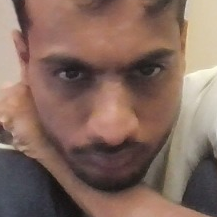

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:16] "POST / HTTP/1.1" 200 -


('Sad', 0.7242324352264404)


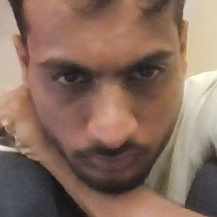

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:17] "POST / HTTP/1.1" 200 -


('Sad', 0.8792933225631714)


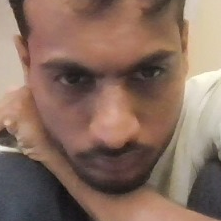

1/1 [==============================] - 0s 39ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:18] "POST / HTTP/1.1" 200 -


('Sad', 0.8034001588821411)


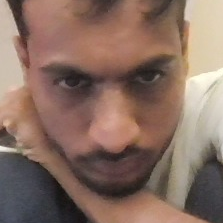

1/1 [==============================] - 0s 41ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:19] "POST / HTTP/1.1" 200 -


('Sad', 0.6649700999259949)


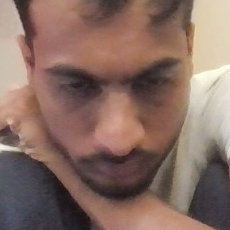

1/1 [==============================] - 0s 73ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:20] "POST / HTTP/1.1" 200 -


('Sad', 0.938788652420044)


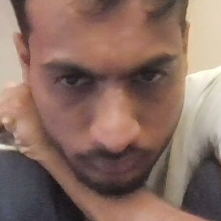

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:21] "POST / HTTP/1.1" 200 -


('Sad', 0.8551926612854004)


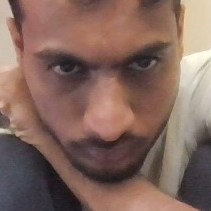

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:22] "POST / HTTP/1.1" 200 -


('Sad', 0.7982781529426575)


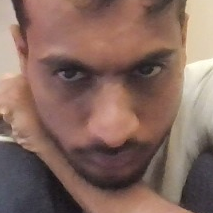

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:23] "POST / HTTP/1.1" 200 -


('Sad', 0.7764817476272583)


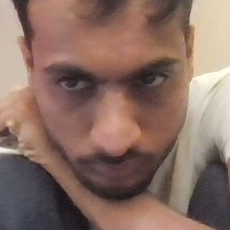

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:24] "POST / HTTP/1.1" 200 -


('Sad', 0.7261977791786194)


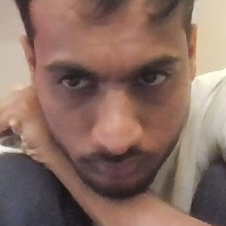

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:25] "POST / HTTP/1.1" 200 -


('Sad', 0.7631768584251404)


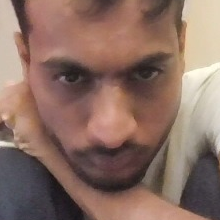

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:26] "POST / HTTP/1.1" 200 -


('Sad', 0.6950129866600037)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:27] "POST / HTTP/1.1" 200 -


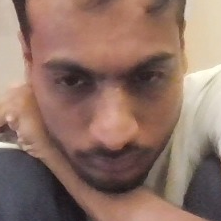

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:28] "POST / HTTP/1.1" 200 -


('Sad', 0.805286705493927)


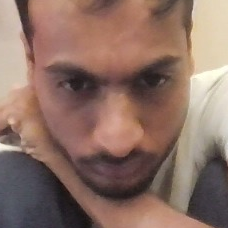

1/1 [==============================] - 0s 34ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:29] "POST / HTTP/1.1" 200 -


('Sad', 0.8545995354652405)


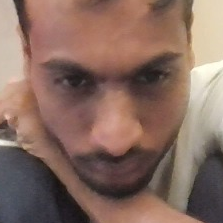

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:30] "POST / HTTP/1.1" 200 -


('Sad', 0.7850786447525024)


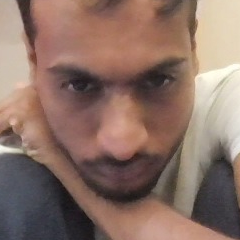

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:31] "POST / HTTP/1.1" 200 -


('Sad', 0.913645327091217)


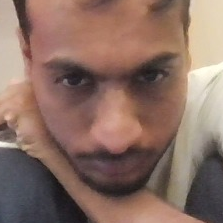

1/1 [==============================] - 0s 47ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:32] "POST / HTTP/1.1" 200 -


('Sad', 0.7427166700363159)


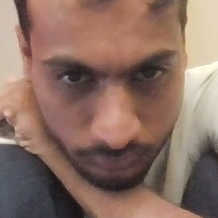

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:33] "POST / HTTP/1.1" 200 -


('Sad', 0.9357733130455017)


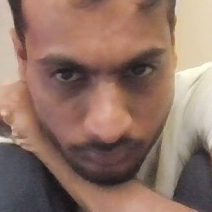

1/1 [==============================] - 0s 40ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:34] "POST / HTTP/1.1" 200 -


('Sad', 0.540341854095459)


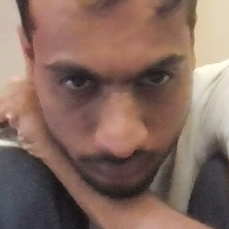

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:35] "POST / HTTP/1.1" 200 -


('Sad', 0.7998478412628174)


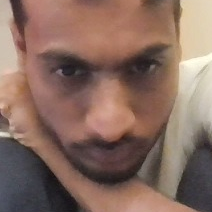

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:36] "POST / HTTP/1.1" 200 -


('Sad', 0.6946300864219666)


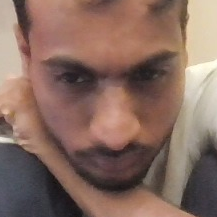

1/1 [==============================] - 0s 53ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:37] "POST / HTTP/1.1" 200 -


('Sad', 0.8925261497497559)


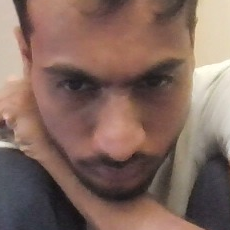

1/1 [==============================] - 0s 53ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:38] "POST / HTTP/1.1" 200 -


('Sad', 0.8353447318077087)


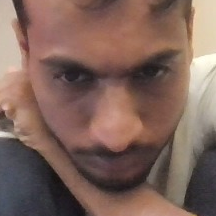

1/1 [==============================] - 0s 47ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:39] "POST / HTTP/1.1" 200 -


('Sad', 0.8469394445419312)


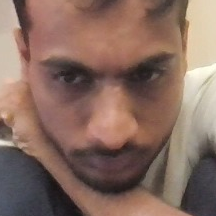

1/1 [==============================] - 0s 51ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:40] "POST / HTTP/1.1" 200 -


('Sad', 0.8901370763778687)


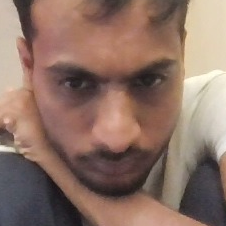

1/1 [==============================] - 0s 91ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:42] "POST / HTTP/1.1" 200 -


('Sad', 0.7391835451126099)


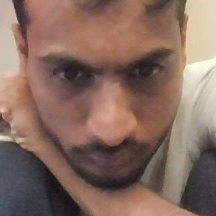

1/1 [==============================] - 0s 219ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:43] "POST / HTTP/1.1" 200 -


('Sad', 0.8084753751754761)


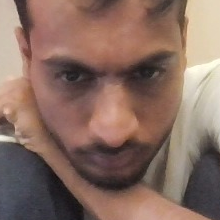

1/1 [==============================] - 0s 230ms/step


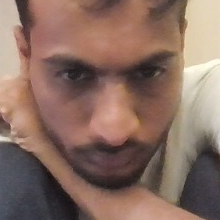

1/1 [==============================] - 0s 416ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:45] "POST / HTTP/1.1" 200 -


('Sad', 0.804410994052887)
1/1 [==============================] - 0s 313ms/step


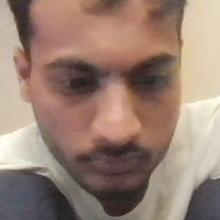

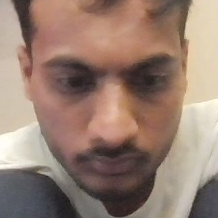

1/1 [==============================] - 0s 323ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:46] "POST / HTTP/1.1" 200 -


('Sad', 0.9508424401283264)
1/1 [==============================] - 0s 196ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:47] "POST / HTTP/1.1" 200 -


('Sad', 0.9043339490890503)


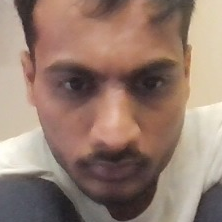

1/1 [==============================] - 0s 173ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:48] "POST / HTTP/1.1" 200 -


('Sad', 0.9252496957778931)


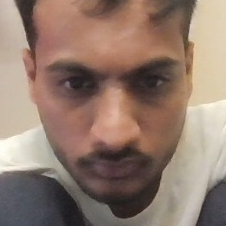

1/1 [==============================] - 0s 156ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:48] "POST / HTTP/1.1" 200 -


('Sad', 0.9467451572418213)
1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:48] "POST / HTTP/1.1" 200 -


('Sad', 0.9876270890235901)


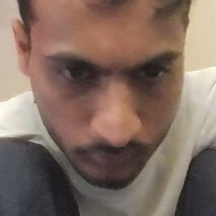

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:49] "POST / HTTP/1.1" 200 -


('Sad', 0.9754546880722046)


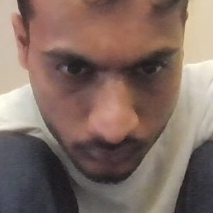

1/1 [==============================] - 0s 105ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:51] "POST / HTTP/1.1" 200 -


('Sad', 0.9399787187576294)


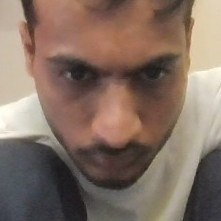

1/1 [==============================] - 0s 230ms/step


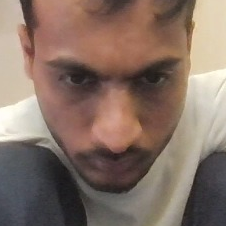

1/1 [==============================] - 0s 140ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:53] "POST / HTTP/1.1" 200 -


('Sad', 0.9818161725997925)
1/1 [==============================] - 0s 104ms/step


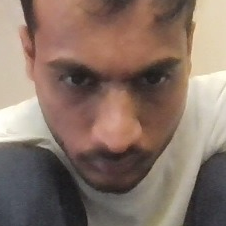

1/1 [==============================] - 0s 148ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:53] "POST / HTTP/1.1" 200 -


('Sad', 0.9729549288749695)
1/1 [==============================] - 0s 83ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:54] "POST / HTTP/1.1" 200 -


('Sad', 0.9726299047470093)


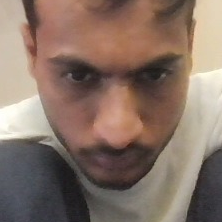

1/1 [==============================] - 0s 92ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:55] "POST / HTTP/1.1" 200 -


('Sad', 0.9911326766014099)


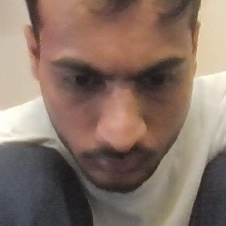

1/1 [==============================] - 0s 57ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:55] "POST / HTTP/1.1" 200 -


('Sad', 0.9960134029388428)


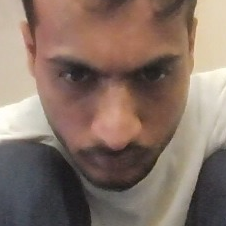

1/1 [==============================] - 0s 50ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:57] "POST / HTTP/1.1" 200 -


('Sad', 0.9768045544624329)


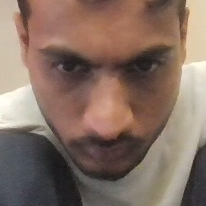

1/1 [==============================] - 0s 94ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:58] "POST / HTTP/1.1" 200 -


('Sad', 0.9610194563865662)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:34:58] "POST / HTTP/1.1" 200 -


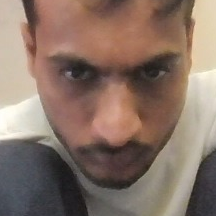

1/1 [==============================] - 0s 120ms/step


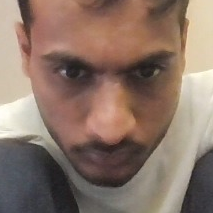

1/1 [==============================] - 0s 136ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:00] "POST / HTTP/1.1" 200 -


('Sad', 0.9045432209968567)
1/1 [==============================] - 0s 130ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:01] "POST / HTTP/1.1" 200 -


('Sad', 0.9239570498466492)


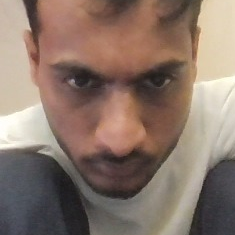

1/1 [==============================] - 0s 141ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:02] "POST / HTTP/1.1" 200 -


('Sad', 0.9782304763793945)


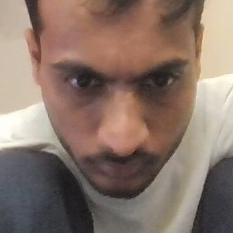

1/1 [==============================] - 0s 122ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:03] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:03] "POST / HTTP/1.1" 200 -


('Sad', 0.9876148700714111)


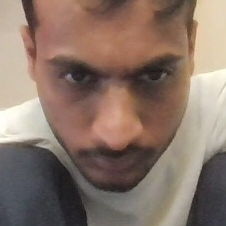

1/1 [==============================] - 0s 38ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:04] "POST / HTTP/1.1" 200 -


('Sad', 0.9347606897354126)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:05] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:06] "POST / HTTP/1.1" 200 -


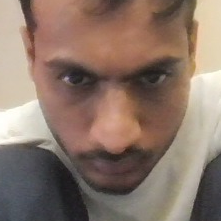

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:07] "POST / HTTP/1.1" 200 -


('Sad', 0.9805186986923218)


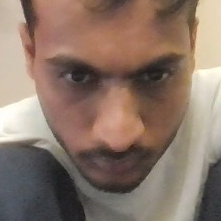

1/1 [==============================] - 0s 36ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:08] "POST / HTTP/1.1" 200 -


('Sad', 0.9544538259506226)


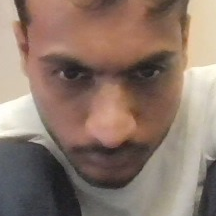

1/1 [==============================] - 0s 48ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:09] "POST / HTTP/1.1" 200 -


('Sad', 0.7539440989494324)


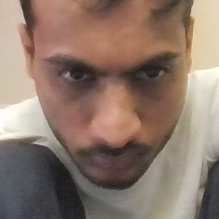

1/1 [==============================] - 0s 37ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:10] "POST / HTTP/1.1" 200 -


('Sad', 0.9529858231544495)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:11] "POST / HTTP/1.1" 200 -


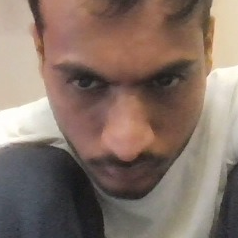

1/1 [==============================] - 0s 76ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:12] "POST / HTTP/1.1" 200 -


('Sad', 0.9597273468971252)


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:13] "POST / HTTP/1.1" 200 -
INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:14] "POST / HTTP/1.1" 200 -


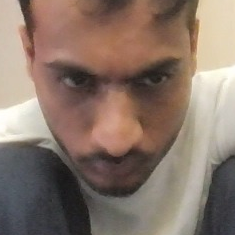

1/1 [==============================] - 0s 164ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:16] "POST / HTTP/1.1" 200 -


('Sad', 0.8585270047187805)


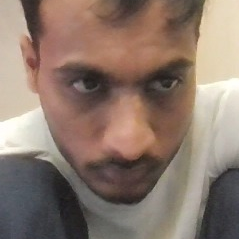

1/1 [==============================] - 0s 35ms/step


INFO:werkzeug:127.0.0.1 - - [26/May/2024 10:35:16] "POST / HTTP/1.1" 200 -


('Sad', 0.6136071085929871)


In [ ]:
from flask import Flask, request, jsonify
import cv2
import numpy as np
import base64
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from google.colab.patches import cv2_imshow
app = Flask(__name__)

# Prevent OpenCL usage and unnecessary logging messages
cv2.ocl.setUseOpenCL(False)

# Define the model architecture

# Load the pre-trained model weights
model = create_model()
model.load_weights('/content/model.h5')

# Dictionary which assigns each label an emotion
emotion_dict = {0:"Happy", 1: "Neutral", 2: "Sad"}

# Load face detection cascade
face_cascade_path = '/content/haarcascade_frontalface_default.xml'
face_cascade = cv2.CascadeClassifier(face_cascade_path)

# Check if the face cascade loaded correctly
if face_cascade.empty():
    raise IOError("Could not load face cascade. Check the path to haarcascade_frontalface_default.xml.")

def detect_and_extract_faces(image, face_cascade):
    faces = face_cascade.detectMultiScale(image, scaleFactor=1.3, minNeighbors=5)
    face_images = []
    coordinates = []
    for (x, y, w, h) in faces:
        face_img = image[y:y+h, x:x+w]
        face_images.append(face_img)
        coordinates.append((x, y, w, h))
    return face_images, coordinates

def predict_emotion(face_img):
    gray_face = cv2.cvtColor(face_img, cv2.COLOR_BGR2GRAY)
    resized_face = cv2.resize(gray_face, (48, 48))
    normalized_face = np.expand_dims(np.expand_dims(resized_face, -1), 0) / 255.0
    prediction = model.predict(normalized_face)
    max_index = int(np.argmax(prediction))
    predicted_emotion = emotion_dict[max_index]
    confidence = float(prediction[0][max_index])
    return predicted_emotion, confidence

@app.route('/', methods=['GET', 'POST'])
def upload_image():
    if request.method == 'POST':
        data = request.json
        img_data = data['image'].split(',')[1]
        nparr = np.frombuffer(base64.b64decode(img_data), np.uint8)
        img = cv2.imdecode(nparr, cv2.IMREAD_COLOR)
        face_images, coordinates = detect_and_extract_faces(img, face_cascade)

        predictions = []
        for face_img, (x, y, w, h) in zip(face_images, coordinates):
            cv2.flip(face_img,0)
            cv2_imshow(face_img)

            label, confidence = predict_emotion(face_img)
            print(predict_emotion(face_img))
            predictions.append({
                'label': label,
                'confidence': confidence,

            })
        return jsonify(predictions)
    return """
    <!DOCTYPE html>
    <html lang="en">
    <head>
        <meta charset="UTF-8">
        <meta name="viewport" content="width=device-width, initial-scale=1.0">
    </head>
    <body>
        <video id="video" width="640" height="480" autoplay></video>
        <canvas id="canvas" width="640" height="480" style="display:none;"></canvas>
        <div id="prediction"></div>
        <script>
            const video = document.getElementById('video');
            const canvas = document.getElementById('canvas');
            const predictionDiv = document.getElementById('prediction');

            async function initCamera() {
                try {
                    const stream = await navigator.mediaDevices.getUserMedia({ video: true });
                    video.srcObject = stream;
                } catch (err) {
                    console.error('Error accessing camera:', err);
                }
            }

            async function captureAndPredict() {
                const context = canvas.getContext('2d');
                context.drawImage(video, 0, 0, canvas.width, canvas.height);
                const imageData = canvas.toDataURL('image/jpeg');
                const response = await fetch('/', {
                    method: 'POST',
                    body: JSON.stringify({ image: imageData }),
                    headers: {
                        'Content-Type': 'application/json'
                    }
                });
                const result = await response.json();

                predictionDiv.innerHTML = JSON.stringify(result, null, 2);
            }

            setInterval(captureAndPredict, 1000);

            initCamera();
        </script>
    </body>
    </html>
    """

if __name__ == '__main__':
    app.run(host='0.0.0.0')


In [18]:
import gdown

file_id = "ABC12345XYZ"  # Replace this with your file's ID
output_file = "data_file.ext"  # Replace "data_file.ext" with the desired output filename and extension

gdown.download("https://drive.google.com/file/d/1yCxHw7aOAPYTVz9VKm2Yax1sxLLtJgWk")

Downloading...
From: https://drive.google.com/file/d/1yCxHw7aOAPYTVz9VKm2Yax1sxLLtJgWk
To: /content/1yCxHw7aOAPYTVz9VKm2Yax1sxLLtJgWk
83.4kB [00:00, 2.52MB/s]


'1yCxHw7aOAPYTVz9VKm2Yax1sxLLtJgWk'

In [19]:
!gdown 1yCxHw7aOAPYTVz9VKm2Yax1sxLLtJgWk


Downloading...
From (original): https://drive.google.com/uc?id=1yCxHw7aOAPYTVz9VKm2Yax1sxLLtJgWk
From (redirected): https://drive.google.com/uc?id=1yCxHw7aOAPYTVz9VKm2Yax1sxLLtJgWk&confirm=t&uuid=b25796d3-0741-4de1-967c-7a58c12ffd04
To: /content/data.zip
100% 67.1M/67.1M [00:02<00:00, 23.1MB/s]


In [31]:
!rm -rf /content/data/train/surprised

Found 13608 images belonging to 3 classes.
Found 3402 images belonging to 3 classes.


17225924/17225924 [==============================] - 0s 0us/step
Epoch 1/30
187/187 [==============================] - ETA: 0s - loss: 1.0829 - accuracy: 0.4198

187/187 [==============================] - 29s 147ms/step - loss: 1.0829 - accuracy: 0.4198 - val_loss: 1.0686 - val_accuracy: 0.4347
Epoch 2/30
187/187 [==============================] - 20s 108ms/step - loss: 1.0729 - accuracy: 0.4317
Epoch 3/30
187/187 [==============================] - 22s 116ms/step - loss: 1.0696 - accuracy: 0.4352
Epoch 4/30
187/187 [==============================] - 20s 107ms/step - loss: 1.0681 - accuracy: 0.4375
Epoch 5/30
187/187 [==============================] - 21s 114ms/step - loss: 1.0685 - accuracy: 0.4356
Epoch 6/30
187/187 [==============================] - 21s 111ms/step - loss: 1.0671 - accuracy: 0.4349
Epoch 7/30
187/187 [==============================] - 21s 114ms/step - loss: 1.0692 - accuracy: 0.4303
Epoch 8/30
187/187 [==============================] - 22s 116ms/step - loss: 1.0705 - accuracy: 0.4312
Epoch 9/30
187/187 [==============================] - 21s 113ms/step - loss: 1.0679 - accuracy: 0.4314
Epoch 10/30
187/187 [=====================